<h1 style="
    font-family: 'Arial', sans-serif;
    font-size: 2.5em;
    background: linear-gradient(90deg, #FF7F50, #1E90FF);
    -webkit-background-clip: text;
    -webkit-text-fill-color: transparent;
    text-align: center;
    text-shadow: 2px 2px 5px rgba(0, 0, 0, 0.3);
    margin-bottom: 20px;
    padding: 10px;
">
  Import Libraries
</h1>

In [3]:
# venv39:
import matplotlib.pyplot as plt
import pandas as pd
from dataprep.datasets import load_dataset  
from dataprep.eda import create_report
import numpy as np
from IPython.display import HTML

# ----------------------------------------

# venv310:
""""
from ydata_profiling import ProfileReport
from autoviz.AutoViz_Class import AutoViz_Class
import sweetviz as sv
from phik import resources, report
import seaborn as sns
import pandas as pd
"""

'"\nfrom ydata_profiling import ProfileReport\nfrom autoviz.AutoViz_Class import AutoViz_Class\nimport sweetviz as sv\nfrom phik import resources, report\nimport seaborn as sns\nimport pandas as pd\n'

<h1 style="
    font-family: 'Arial', sans-serif;
    font-size: 2.5em;
    background: linear-gradient(90deg, #FF7F50, #1E90FF);
    -webkit-background-clip: text;
    -webkit-text-fill-color: transparent;
    text-align: center;
    text-shadow: 2px 2px 5px rgba(0, 0, 0, 0.3);
    margin-bottom: 20px;
    padding: 10px;
">
  Loading and analyzing the Machine Failure dataset
</h1>

In [2]:
df = pd.read_csv("Datasets/maintenance.csv")
df.head()

,UDI,Product ID,Type,Air temperature [K],Process temperature [K],Rotational speed [rpm],Torque [Nm],Tool wear [min],Machine failure,TWF,HDF,PWF,OSF,RNF
0,1,M14860,M,298.1,308.6,1551,42.8,0,0,0,0,0,0,0
1,2,L47181,L,298.2,308.7,1408,46.3,3,0,0,0,0,0,0
2,3,L47182,L,298.1,308.5,1498,49.4,5,0,0,0,0,0,0
3,4,L47183,L,298.2,308.6,1433,39.5,7,0,0,0,0,0,0
4,5,L47184,L,298.2,308.7,1408,40.0,9,0,0,0,0,0,0


In [3]:
# Air temperature[k] and Process temperature [k] are im degrees Kelvin and for better understanding, I convert them to degrees Celsius
df['Air temperature [K]'] = df['Air temperature [K]'] - 273.15
df['Process temperature [K]'] = df['Process temperature [K]'] - 273.15
df = df.rename(columns={'Air temperature [K]': 'Air temperature [C]', 'Process temperature [K]': 'Process temperature [C]'})

In [4]:
df.head()

,UDI,Product ID,Type,Air temperature [C],Process temperature [C],Rotational speed [rpm],Torque [Nm],Tool wear [min],Machine failure,TWF,HDF,PWF,OSF,RNF
0,1,M14860,M,24.95,35.45,1551,42.8,0,0,0,0,0,0,0
1,2,L47181,L,25.05,35.55,1408,46.3,3,0,0,0,0,0,0
2,3,L47182,L,24.95,35.35,1498,49.4,5,0,0,0,0,0,0
3,4,L47183,L,25.05,35.45,1433,39.5,7,0,0,0,0,0,0
4,5,L47184,L,25.05,35.55,1408,40.0,9,0,0,0,0,0,0


In [5]:
# Now it looks better

In [6]:
# Loading the dataset with DataPrep library and creating a report
#report = create_report(df)  
#report.show_browser()  
# Save the report to a file
#report.save("Datasets/maintenance_report.html")


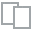
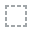
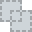
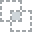
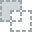
...
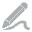
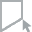
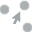
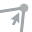
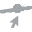

In [7]:
# Loading the maintenance_report.html file
HTML(filename="Datasets/maintenance_report.html")

## <span style="color: #20C997;">Personal Analysis</span>
The dataset has 14 variables and 10,000 rows, with no missing or duplicate values. 
#### The report shows: 
UDI is a unique identifier for each record.<br>
Air temperature [C] and Process temperature [C] have a normal distribution, because mean is not bigger than median and have short ranges.<br>
Rotation speed is skewed to the right, because mean is bigger than median and have a long range and kurtosis is bigger than 0.<br>
Type is a categorical column with 3 values and is imbalanced. L is more frequent than M and H.<br>
Rotational speed has normal distribution, because mean is not bigger than median and have short range and not skewed<br>
Torque has normal distribution.<br>
Tool Wear Failure has normal distribution, but has 120 zeros values, I have to search about it, do they have a meaning or are they missing values?<br>
<span style="color:red;">Now I got it, When machines use tools to shape or cut materials, those tools slowly wear out over time because of the heat, pressure, and friction.<br>
What I see from distribution, the minimum value is 0, and the maximum reaches 253 minutes, so zeros are meaningful because it shows that tool is not begun yet or tools are fresh.</span><br>
Rest of Columns which are categorical are Imbalanced. The 0 value is more frequent than 1. I need search about it, why it is like that?<br>
<span style="color:red;">Now I got it, because 0 means not failure so in real lifeF, failure of machines should be rare.</span>

What I got from scatter plot between TWF and Tool wear, both failures are detected in 203 min and 217 min, which means failures are not happened lower than 200 min.<br> Some tools got to higher than 217 min but failure is not happened, I think time alone is not the reason of failure, quality of tools or some others factors are more reasonable.<br><br>
Scatter plot and correlation heatmap show me that HDF is related more Air temperature and Torque than others but why than process temperature?,<br> I have to figure out about this!
<span style="color:red;"> What I leaned after googling, causes a process failure if the difference between the air temperature and the process temperature is less than 8.6 C.<br>
When machines release heat into the air, bigger the difference between the machine's heat and the air, the faster it cools.<br> If the air is already warm, it's harder for the machines to cool down because the heat does not have anywhere to go.
Why air temperature has more impact than process temperature because machines are designed to handle owm heat.</span><br>
HDF is related to Torque as well, HDF is happened when Torque is between 15 and 35 Nm, I am thinking why in this range, does it make scene, when machines are too high and too low, the HDF is 0.<br>
PWF(Power failure) is related with Torque and Rotational speed , what I see from scatter, when Torque is too high, PWF is 1.
<br><br>
OSF (OverStrain Failure) has correlation with Torque, Tool wear and  moderate correlation with Power failure, I got this from google:<br>
<span style="color:red;">OverStrain Failure (OSF): if the product of tool wear and torque exceeds 11,000 minimum Nm for the L product variant (12,000 for M, 13,000 for H), the process fails due to overstrain.<br>
Since both OSF and power failure are influenced by Torque, it makes sense.</span><br> 

Rotational Speed has strong negative correlation with Torque, which means <span style="color:red;"> when you need more force to turn something heavy or resist more load, the machine naturally slows down because it's working harder.<br> It's like trading speed for strength, what I learned from scatter plot between torque and rotational speed. At the lower rotational speed, torque is vary widely which means machines are more used in lower speeds. <br> At higher speed and lower torque, distribution is narrow which means, using machines with high speed is not common.</span><br>

<br> HDF has stronger correlation with machine failure than TWF, PWF, OSF and RNF which means <span style="color:red;"> most of the time machine overheats. <br> As I mentioned previously HDF happens when the difference between air temperature and process temperature is less than 8.6°C, so cooling system does not work well or hot location.</span><br>
OSF is the second factor of machine failure, OSF happens  when the product of Torque and Tool Wear exceeds a specific threshold, depending on product quality (L, M, H).<br>
PWF is third cause of machine failure, PWF happens when the machine's power goes out of its safe range because of interaction of torque and rotational speed. <br>
TWF is the fourth cause of machine failure, TWF happens because tools wear out after a certain amount of use.<br>
UDI has correlation with both Air temperature and Process temperature, Since UDI is unique identifier, it can show processing over time, it has lower correlation with air temperature 

In [ ]:
# Analyzing the dataset with Pandas Profiling 
#profile = ProfileReport(df, title='Pandas Profiling Report')
# Saving the report to a file in HTML format
#profile.to_file("Datasets/maintenance_Pandas_Profiling_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## <span style="color: #20C997;">Personal Analysis</span>
Pandas Profiling Report shows 18 alerts, some features have high correlation to each other, 6 categorical features are imbalanced, and Pandas profiling does not  provide new insights about the dataset what DataPrep library could not provide.

In [ ]:
#AV = AutoViz_Class()
# Visualize the dataset
#dft = AV.AutoViz(df)

Shape of your Data Set loaded: (10000, 14)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    Number of Numeric Columns =  3
    Number of Integer-Categorical Columns =  2
    Number of String-Categorical Columns =  1
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  6
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  2
    Number of Columns to Delete =  0
    14 Predictors classified...
        2 variable(s) removed since they were ID or low-information variables
        List of variables removed: ['UDI', 'Product ID']
To fix these data quality issues in the datas

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
UDI,int64,0.000000,100,1.000000,10000.000000,Possible ID column: drop before modeling step.
Product ID,object,0.000000,100,,,Possible ID column: drop before modeling step.
Type,object,0.000000,0,,,No issue
Air temperature [C],float64,0.000000,NA,22.150000,31.350000,No issue
Process temperature [C],float64,0.000000,NA,32.550000,40.650000,Column has a high correlation with ['Air temperature [C]']. Consider dropping one of them.
Rotational speed [rpm],int64,0.000000,9,1168.000000,2886.000000,"Column has 418 outliers greater than upper bound (1895.50) or lower than lower bound(1139.50). Cap them or remove them., Column has a high correlation with ['Torque [Nm]']. Consider dropping one of them."
Torque [Nm],float64,0.000000,NA,3.800000,76.600000,Column has 69 outliers greater than upper bound (67.20) or lower than lower bound(12.80). Cap them or remove them.
Tool wear [min],int64,0.000000,2,0.000000,253.000000,No issue
Machine failure,int64,0.000000,0,0.000000,1.000000,No issue
TWF,int64,0.000000,0,0.000000,1.000000,No issue


Number of All Scatter Plots = 6
All Plots done
Time to run AutoViz = 3 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


## <span style="color: #20C997;">Personal Analysis</span>
AutoViz shows that Rotational Speed has 418 outliers and has high correlation with Torque.<br>
Torque has 69 outliers. Air temperature has strong correlation with process temperature.

In [13]:
#report = sv.analyze(df)
#report.show_html("Datasets/maintenance_sweetviz_report.html")

                                             |          | [  0%]   00:00 -> (? left)

Report maintenance_sweetviz_report.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


## <span style="color: #20C997;">Personal Analysis</span>
Sweetvis does not provide new insights what Data_Pred could not.

In [15]:
# Calculate the phik matrix
#phik_overview = df.phik_matrix()
#phik_overview

interval columns not set, guessing: ['UDI', 'Air temperature [C]', 'Process temperature [C]', 'Rotational speed [rpm]', 'Torque [Nm]', 'Tool wear [min]', 'Machine failure', 'TWF', 'HDF', 'PWF', 'OSF', 'RNF']


,UDI,Product ID,Type,Air temperature [C],Process temperature [C],Rotational speed [rpm],Torque [Nm],Tool wear [min],Machine failure,TWF,HDF,PWF,OSF,RNF
UDI,1.000000,1.0,0.000000,0.901887,0.847830,0.037301,0.032157,0.000000,0.238465,0.000000,0.392016,0.016920,0.000000,0.040020
Product ID,1.000000,1.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Type,0.000000,1.0,1.000000,0.027828,0.022919,0.005016,0.000000,0.000000,0.020646,0.000000,0.002458,0.004130,0.034194,0.010312
Air temperature [C],0.901887,1.0,0.027828,1.000000,0.923235,0.037658,0.039935,0.111049,0.160864,0.000000,0.264614,0.000000,0.000000,0.000000
Process temperature [C],0.847830,1.0,0.022919,0.923235,1.000000,0.000000,0.029331,0.131704,0.087284,0.000000,0.135163,0.019043,0.000000,0.017601
Rotational speed [rpm],0.037301,1.0,0.005016,0.037658,0.000000,1.000000,0.937916,0.000000,0.448734,0.000000,0.237838,0.658560,0.191970,0.000000
Torque [Nm],0.032157,1.0,0.000000,0.039935,0.029331,0.937916,1.000000,0.000000,0.585491,0.017063,0.227078,0.845246,0.356773,0.021276
Tool wear [min],0.000000,1.0,0.000000,0.111049,0.131704,0.000000,0.000000,1.000000,0.278363,0.330997,0.000000,0.000000,0.345249,0.000000
Machine failure,0.238465,1.0,0.020646,0.160864,0.087284,0.448734,0.585491,0.278363,1.000000,0.534104,0.783517,0.728856,0.737738,0.000000
TWF,0.000000,1.0,0.000000,0.000000,0.000000,0.000000,0.017063,0.330997,0.534104,1.000000,0.000000,0.000000,0.045648,0.015395


## <span style="color: #20C997;">Personal Analysis</span>
Phik shows higher correlation between PWF, Torque and Rotational speed than Data_Prep.<br>
Rotational speed has strong correlation  with Torque, Machine Failure and Power failure.<br>
Torque has strong correlation Rotational Speed, Machine Failure, power failure and overstrain failure.<br>
Tool wear has correlation with overstrain failure, WTF and Machine Failure.<br>
For Machine Failure, Phik shows stronger correlation with HDF(0.78) while Data Prep showed 0.58, and for others Failure modes is same.

<h1 style="
    font-family: 'Arial', sans-serif;
    font-size: 2.5em;
    background: linear-gradient(90deg, #FF7F50, #1E90FF);
    -webkit-background-clip: text;
    -webkit-text-fill-color: transparent;
    text-align: center;
    text-shadow: 2px 2px 5px rgba(0, 0, 0, 0.3);
    margin-bottom: 20px;
    padding: 10px;
">
  Loading and Analyzing Customer Churn
</h1>

# Dataset Description for Regression (Customer Value)

This dataset comes from an Iranian telecom company and contains 3150 rows, where each row represents a customer.<br> The dataset has 13 features and is used to understand customer behavior. For regression, the goal is to predict **Customer Value** (a continuous number).

## Features for Regression (Customer Value):
1. **Call Failure**: Number of times calls failed.
2. **Complains**: 0 = No complaints, 1 = Complained.
3. **Subscription Length**: How long the customer has been subscribed (in months).
4. **Charge Amount**: Total amount charged to the customer.
5. **Seconds of Use**: Total seconds the customer used the service.
6. **Frequency of Use**: How often the customer used the service.
7. **Frequency of SMS**: How many SMS messages the customer sent.
8. **Distinct Called Numbers**: Number of unique phone numbers the customer called.
9. **Age Group**: Age category of the customer.
10. **Tariff Plan**: Type of plan the customer is using.
11. **Status**: Whether the customer is active or inactive (0 or 1).
12. **Age**: Customer’s exact age.
13. **Churn**: 0 = Did not leave the service, 1 = Left the service.
14. **Customer Value**: Represents how much value or revenue the customer has brought to the company.

In [ ]:
# Loading the Dataset
data = pd.read_csv("Datasets/Customer Churn.csv")
data.head(5)

,Call Failure,Complains,Subscription Length,Charge Amount,Seconds of Use,Frequency of use,Frequency of SMS,Distinct Called Numbers,Age Group,Tariff Plan,Status,Age,Customer Value,Churn
0,8,0,38,0,4370,71,5,17,3,1,1,30,197.640,0
1,0,0,39,0,318,5,7,4,2,1,2,25,46.035,0
2,10,0,37,0,2453,60,359,24,3,1,1,30,1536.520,0
3,10,0,38,0,4198,66,1,35,1,1,1,15,240.020,0
4,3,0,38,0,2393,58,2,33,1,1,1,15,145.805,0


In [7]:
# Analyzing the dataset with DataPrep library
report = create_report(data)
report.show_browser()
#Save the report to a file
report.save("Datasets/customer_churn_report.html")

  0%|          | 0/2116 [00:00<?, ?it/s]

c:\Users\murta\Desktop\Desktop\ML&DE\Third-semester\Advanced_Data_Analytics\venv39\lib\site-packages\dask\core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


Report has been saved to Datasets\customer_churn_report.html!



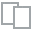
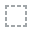
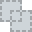
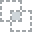
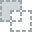
...
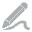
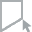
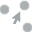
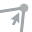
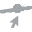

In [8]:
# Loading the customer_churn_report.html file
HTML(filename="Datasets/customer_churn_report.html")

## <span style="color: #20C997;">Personal Analysis</span>
With quick looking at overview, The dataset has 3,150 rows and 14 features (8 numeric, 6 categorical) with no missing data but 300 duplicate rows. 
<br>1-The Call Failure feature is right-skewed and has 702 zero values.
<br>2-The Complains feature is categorical with two values (0 and 1). It is imbalanced feature, with 2,909 entries (92.3%) 0 and only 241 entries (7.7%)1. There are no missing values.
<br>3-The Subscription Length feature goes from 3 to 47, with an average of 32.5 and a middle value (median) of 35. Most values are between 30 and 38, and the data is slightly skewed to the left. The values are spread out by about 8.57 on average (standard deviation). There are no missing or zero values.
<br>3-The Charge Amount feature's values are between 0 to 10, with an average of 0.94 and a middle value (median) of 0. Over half of the values (56.1%) are zero. The data is skewed to the right.
<br>4-The Seconds of Use' values are between 0 to 17,090, with an average of 4,472.5 and a middle value (median) of 2,990. Around 4.9% of the values are zero, and the data has a wide range, with a standard deviation of 4,197.9. The data is skewed to the right (1.32), meaning some users have very high usage.
<br>5-The Frequency of Use feature ranges from 0 to 255, with an average of 69.5 and a median of 54. About 4.9% of the values are zero. The data is right-skewed (1.14), with most values between 27 and 95 (IQR: 68). The standard deviation is 57.4, showing moderate spread.
<br>6-The Frequency of SMS feature ranges from 0 to 522, with an average of 73.2 and a median of 21. Around 19.1% of the values are zero, meaning many users sent no SMS. The data is highly right-skewed (1.97), with most values clustered below 87 (IQR: 81). The standard deviation is 112.2, showing wide variation.
<br>7-The Distinct Called Numbers feature ranges from 0 to 97, with an average of 23.5 and a median of 21. About 4.9% of values are zero. The data is right-skewed (1.03), with most values between 10 and 34 (IQR: 24). The standard deviation is 17.2, showing moderate variation.
<br>8-The Age Group feature has 5 categories, with no missing data. The most common category is "3," with 1,425 entries, followed by "2" with 1,037. The categories are evenly spread.
<br>9-The Tariff Plan feature has two categories, with the first category (1) having 2,905 entries and the second category (2) having 245 entries, having an imbalanced distribution. There are no missing values or unique data issues.
<br>10-The Age feature is categorical with 5 distinct values (15, 25, 30, 45, 55). The most frequent age group is 30.
<br>11-The Customer Value feature ranges from 0 to 2165.28, with an average of 470.97 and a middle value (median) of 228.48. About 4.2% of the values are zero, which means some customers are not active or have no recording. The Feature is unevenly spread, with a few customers having much higher values than most. The standard deviation is 517.02, showing that the values vary a lot, and the middle 50% of values are between 113.80 and 788.39.
<br>12-The Churn feature has two categories: 0  and 1. (about 84%) are non-churners, and 495 entries (about 16%) are churners. There are no missing values in this feature. The data shows an imbalance.

<h1 style="
    font-family: 'Arial', sans-serif;
    font-size: 2.5em;
    background: linear-gradient(90deg, #FF7F50, #1E90FF);
    -webkit-background-clip: text;
    -webkit-text-fill-color: transparent;
    text-align: center;
    text-shadow: 2px 2px 5px rgba(0, 0, 0, 0.3);
    margin-bottom: 20px;
    padding: 10px;
">
  Loading and Analyzing Customer Churn and maintenance  datasets with AutoViz Class
</h1>

In [7]:
# Load the dataset with AutoViz
AV = AutoViz_Class()
data = pd.read_csv("Customer Churn.csv")

# Visualize the dataset
dft = AV.AutoViz(data)

Shape of your Data Set loaded: (3150, 14)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    Number of Numeric Columns =  1
    Number of Integer-Categorical Columns =  9
    Number of String-Categorical Columns =  0
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  4
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  0
    14 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
To fix these data quality issues in the dataset, import FixDQ from autoviz...
There are 300 d

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
Call Failure,int64,0.000000,1,0.000000,36.000000,Column has 44 outliers greater than upper bound (28.50) or lower than lower bound(-15.50). Cap them or remove them.
Complains,int64,0.000000,0,0.000000,1.000000,No issue
Subscription Length,int64,0.000000,1,3.000000,47.000000,Column has 208 outliers greater than upper bound (51.50) or lower than lower bound(15.50). Cap them or remove them.
Charge Amount,int64,0.000000,0,0.000000,10.000000,Column has 62 outliers greater than upper bound (5.00) or lower than lower bound(-3.00). Cap them or remove them.
Seconds of Use,int64,0.000000,61,0.000000,17090.000000,Column has 189 outliers greater than upper bound (14061.88) or lower than lower bound(-6103.12). Cap them or remove them.
Frequency of use,int64,0.000000,8,0.000000,255.000000,"Column has 118 outliers greater than upper bound (198.00) or lower than lower bound(-74.00). Cap them or remove them., Column has a high correlation with ['Seconds of Use']. Consider dropping one of them."
Frequency of SMS,int64,0.000000,14,0.000000,522.000000,"Column has 333 outliers greater than upper bound (209.50) or lower than lower bound(-114.50). Cap them or remove them., Column has a high correlation with ['Customer Value']. Consider dropping one of them."
Distinct Called Numbers,int64,0.000000,3,0.000000,97.000000,Column has 82 outliers greater than upper bound (68.50) or lower than lower bound(-23.50). Cap them or remove them.
Age Group,int64,0.000000,0,1.000000,5.000000,Column has 154 outliers greater than upper bound (4.50) or lower than lower bound(0.50). Cap them or remove them.
Tariff Plan,int64,0.000000,0,1.000000,2.000000,No issue


All Plots done
Time to run AutoViz = 2 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


## <span style="color: #20C997;">Personal Analysis</span>
The dataset has 300 duplicate rows,Several columns have outliers: Call Failure (44 outliers), Complains (208 outliers), Subscription Length (62 outliers), Charge Amount (189 outliers), Seconds of Use (118 outliers), Frequency of SMS (333 outliers), Distinct Called Numbers (82 outliers), Age Group (154 outliers), Age  (633 outliers), and Customer Value (104 outliers).All columns have complete values, with no missing value.

interval columns not set, guessing: ['UDI', 'Air temperature [C]', 'Process temperature [C]', 'Rotational speed [rpm]', 'Torque [Nm]', 'Tool wear [min]', 'Machine failure', 'TWF', 'HDF', 'PWF', 'OSF', 'RNF']


,UDI,Product ID,Type,Air temperature [C],Process temperature [C],Rotational speed [rpm],Torque [Nm],Tool wear [min],Machine failure,TWF,HDF,PWF,OSF,RNF
UDI,1.000000,1.0,0.000000,0.901887,0.847830,0.037301,0.032157,0.000000,0.238465,0.000000,0.392016,0.016920,0.000000,0.040020
Product ID,1.000000,1.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Type,0.000000,1.0,1.000000,0.027828,0.022919,0.005016,0.000000,0.000000,0.020646,0.000000,0.002458,0.004130,0.034194,0.010312
Air temperature [C],0.901887,1.0,0.027828,1.000000,0.923235,0.037658,0.039935,0.111049,0.160864,0.000000,0.264614,0.000000,0.000000,0.000000
Process temperature [C],0.847830,1.0,0.022919,0.923235,1.000000,0.000000,0.029331,0.131704,0.087284,0.000000,0.135163,0.019043,0.000000,0.017601
Rotational speed [rpm],0.037301,1.0,0.005016,0.037658,0.000000,1.000000,0.937916,0.000000,0.448734,0.000000,0.237838,0.658560,0.191970,0.000000
Torque [Nm],0.032157,1.0,0.000000,0.039935,0.029331,0.937916,1.000000,0.000000,0.585491,0.017063,0.227078,0.845246,0.356773,0.021276
Tool wear [min],0.000000,1.0,0.000000,0.111049,0.131704,0.000000,0.000000,1.000000,0.278363,0.330997,0.000000,0.000000,0.345249,0.000000
Machine failure,0.238465,1.0,0.020646,0.160864,0.087284,0.448734,0.585491,0.278363,1.000000,0.534104,0.783517,0.728856,0.737738,0.000000
TWF,0.000000,1.0,0.000000,0.000000,0.000000,0.000000,0.017063,0.330997,0.534104,1.000000,0.000000,0.000000,0.045648,0.015395


<h1 style="
    font-family: 'Arial', sans-serif;
    font-size: 2.5em;
    background: linear-gradient(90deg, #FF7F50, #1E90FF);
    -webkit-background-clip: text;
    -webkit-text-fill-color: transparent;
    text-align: center;
    text-shadow: 2px 2px 5px rgba(0, 0, 0, 0.3);
    margin-bottom: 20px;
    padding: 10px;
">
  Loading and Analyzing Customer Churn and maintenance  datasets with Sweetvize
</h1>

In [9]:
# Load the dataset with sweetviz
data = pd.read_csv("Customer Churn.csv")
report = sv.analyze(data)
report.show_html("customer_churn_sweet.html")

                                             |          | [  0%]   00:00 -> (? left)

Report customer_churn_sweet.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


## <span style="color: #20C997;">Personal Analysis</span>
Most customers have not complained, and Customer Value shows a wide range with higher values connected to lower churn. The churn variable is imbalanced. Churn as the target variable is  skewed. Call Failure  Charge Amount, Seconds of Use, Frequency of Use, and Frequency of SMS. Subscription Length are skew toward shorter durations.

<h1 style="
    font-family: 'Arial', sans-serif;
    font-size: 2.5em;
    background: linear-gradient(90deg, #FF7F50, #1E90FF);
    -webkit-background-clip: text;
    -webkit-text-fill-color: transparent;
    text-align: center;
    text-shadow: 2px 2px 5px rgba(0, 0, 0, 0.3);
    margin-bottom: 20px;
    padding: 10px;
">
  Analyzing Customer Churn and maintenance  datasets with Phik-matrix
</h1>

In [10]:
# Load the dataset with phik
data = pd.read_csv("maintenance.csv")

# Calculate the phik matrix
phik_overview = data.phik_matrix()
phik_overview


interval columns not set, guessing: ['UDI', 'Air temperature [K]', 'Process temperature [K]', 'Rotational speed [rpm]', 'Torque [Nm]', 'Tool wear [min]', 'Machine failure', 'TWF', 'HDF', 'PWF', 'OSF', 'RNF']


,UDI,Product ID,Type,Air temperature [K],Process temperature [K],Rotational speed [rpm],Torque [Nm],Tool wear [min],Machine failure,TWF,HDF,PWF,OSF,RNF
UDI,1.000000,1.0,0.000000,0.901887,0.847830,0.037301,0.032157,0.000000,0.238465,0.000000,0.392016,0.016920,0.000000,0.040020
Product ID,1.000000,1.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Type,0.000000,1.0,1.000000,0.027828,0.022919,0.005016,0.000000,0.000000,0.020646,0.000000,0.002458,0.004130,0.034194,0.010312
Air temperature [K],0.901887,1.0,0.027828,1.000000,0.923235,0.037658,0.039935,0.111049,0.160864,0.000000,0.264614,0.000000,0.000000,0.000000
Process temperature [K],0.847830,1.0,0.022919,0.923235,1.000000,0.000000,0.029331,0.131704,0.087284,0.000000,0.135163,0.019043,0.000000,0.017601
Rotational speed [rpm],0.037301,1.0,0.005016,0.037658,0.000000,1.000000,0.937916,0.000000,0.448734,0.000000,0.237838,0.658560,0.191970,0.000000
Torque [Nm],0.032157,1.0,0.000000,0.039935,0.029331,0.937916,1.000000,0.000000,0.585491,0.017063,0.227078,0.845246,0.356773,0.021276
Tool wear [min],0.000000,1.0,0.000000,0.111049,0.131704,0.000000,0.000000,1.000000,0.278363,0.330997,0.000000,0.000000,0.345249,0.000000
Machine failure,0.238465,1.0,0.020646,0.160864,0.087284,0.448734,0.585491,0.278363,1.000000,0.534104,0.783517,0.728856,0.737738,0.000000
TWF,0.000000,1.0,0.000000,0.000000,0.000000,0.000000,0.017063,0.330997,0.534104,1.000000,0.000000,0.000000,0.045648,0.015395


## <span style="color: #20C997;">Personal Analysis</span>
The matrix shows strong correlation between Rotational speed and Torque (0.94) and between Air temperature and Process temperature (0.92). Machine failure are HDF (0.78) and OSF (0.73).

In [11]:
# Load the dataset with phik
data = pd.read_csv("Customer Churn.csv")

# Calculate the phik matrix
phik_overview = data.phik_matrix()
phik_overview

interval columns not set, guessing: ['Call  Failure', 'Complains', 'Subscription  Length', 'Charge  Amount', 'Seconds of Use', 'Frequency of use', 'Frequency of SMS', 'Distinct Called Numbers', 'Age Group', 'Tariff Plan', 'Status', 'Age', 'Customer Value', 'Churn']


,Call Failure,Complains,Subscription Length,Charge Amount,Seconds of Use,Frequency of use,Frequency of SMS,Distinct Called Numbers,Age Group,Tariff Plan,Status,Age,Customer Value,Churn
Call Failure,1.000000,0.221391,0.393630,0.710498,0.637996,0.717011,0.302474,0.626590,0.241750,0.293079,0.158626,0.241750,0.524792,0.045643
Complains,0.221391,1.000000,0.179273,0.081930,0.206787,0.186296,0.163629,0.101599,0.056053,0.000000,0.410767,0.056053,0.186653,0.739841
Subscription Length,0.393630,0.179273,1.000000,0.320153,0.409170,0.467856,0.503407,0.502920,0.370226,0.299681,0.253007,0.370226,0.374263,0.282007
Charge Amount,0.710498,0.081930,0.320153,1.000000,0.668243,0.608364,0.317253,0.537064,0.510310,0.478096,0.418550,0.510310,0.418279,0.229603
Seconds of Use,0.637996,0.206787,0.409170,0.668243,1.000000,0.929748,0.709112,0.818612,0.609349,0.406160,0.758516,0.609349,0.808966,0.459374
Frequency of use,0.717011,0.186296,0.467856,0.608364,0.929748,1.000000,0.670599,0.867369,0.508050,0.547833,0.688190,0.508050,0.816699,0.440846
Frequency of SMS,0.302474,0.163629,0.503407,0.317253,0.709112,0.670599,1.000000,0.551520,0.392132,0.584950,0.448676,0.392132,0.916134,0.330681
Distinct Called Numbers,0.626590,0.101599,0.502920,0.537064,0.818612,0.867369,0.551520,1.000000,0.518729,0.285493,0.579485,0.518729,0.673250,0.385619
Age Group,0.241750,0.056053,0.370226,0.510310,0.609349,0.508050,0.392132,0.518729,1.000000,0.157408,0.161201,1.000000,0.471688,0.108035
Tariff Plan,0.293079,0.000000,0.299681,0.478096,0.406160,0.547833,0.584950,0.285493,0.157408,1.000000,0.251459,0.157408,0.562542,0.160633


## <span style="color: #20C997;">Personal Analysis</span>
The matrix shows strong correlation between Frequency of Use and Seconds of Use (0.93) and between Customer Value and Frequency of Use (0.82). Key churn predictors are Complaints (0.73) and Status (0.70).

## <span style="color: #20C997;">Future Operation Plan:</span>
Balance class distributions (SMOTE).
<br>Handle noise and outliers.
<br>Missing data with imputation or exclusion.
<br>Normalize or standardize numerical variables.
<br>Perform feature selection to remove redundancy.
<br> Categorical variables (one-hot encoding).
<br>Consider dimensionality reduction (e.g., PCA).

<h1 style="
    font-family: 'Arial', sans-serif;
    font-size: 2.5em;
    background: linear-gradient(90deg, #FF7F50, #1E90FF);
    -webkit-background-clip: text;
    -webkit-text-fill-color: transparent;
    text-align: center;
    text-shadow: 2px 2px 5px rgba(0, 0, 0, 0.3);
    margin-bottom: 20px;
    padding: 10px;
">
  Advanced tasks for extra points:
</h1>

In [12]:
data = pd.read_csv("Customer Churn.csv")
data.head()

,Call Failure,Complains,Subscription Length,Charge Amount,Seconds of Use,Frequency of use,Frequency of SMS,Distinct Called Numbers,Age Group,Tariff Plan,Status,Age,Customer Value,Churn
0,8,0,38,0,4370,71,5,17,3,1,1,30,197.640,0
1,0,0,39,0,318,5,7,4,2,1,2,25,46.035,0
2,10,0,37,0,2453,60,359,24,3,1,1,30,1536.520,0
3,10,0,38,0,4198,66,1,35,1,1,1,15,240.020,0
4,3,0,38,0,2393,58,2,33,1,1,1,15,145.805,0


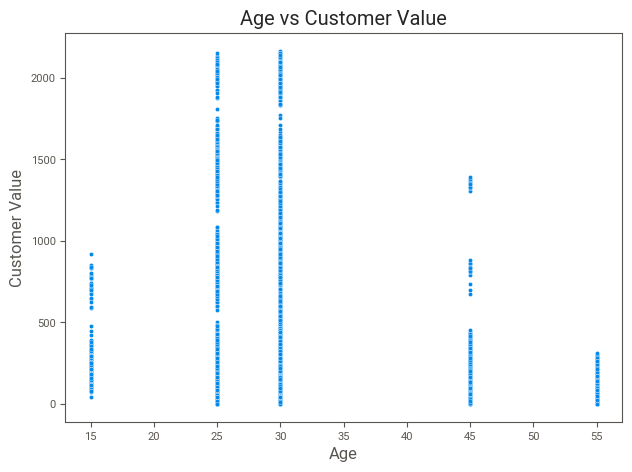

In [13]:
# Customer Churn dataset
import seaborn as sns
%matplotlib inline

# Visualize the Age and Customer Value
sns.scatterplot(data=data, x="Age", y="Customer Value")
plt.title("Age vs Customer Value")
plt.show()


## <span style="color: #20C997;">Personal Analysis:</span>
Older customers have higher customer value than younger customers, specifically 25-30 have high value than others.


In [14]:
# Churn value can be the target values 
X = data.drop("Churn", axis=1)
y = data["Churn"]


# Feature Selection Algorithms

from sklearn.feature_selection import SelectKBest, chi2
from skfeature.function.similarity_based import fisher_score  

# convert all continuous variables to integer,
# and convert all negative numbers to 0
X_cat = X.astype(int)
X_cat = X_cat.clip(lower=0)

chi_features = SelectKBest(chi2, k=len(X_cat.columns))

# fit our data to the SelectKBest
best_features = chi_features.fit(X_cat, y.astype(int))

# use decimal format in table
pd.options.display.float_format = '{:.2f}'.format

# the higher the score, the more effect that column has on the target
df_features = pd.DataFrame(best_features.scores_)
df_columns = pd.DataFrame(X_cat.columns)
f_scores = pd.concat([df_columns, df_features], axis=1)
f_scores.columns = ['Features', 'Score']
f_scores.sort_values(by='Score', ascending=False)

,Features,Score
4,Seconds of Use,1108777.51
12,Customer Value,149516.84
6,Frequency of SMS,26418.16
5,Frequency of use,13750.26
7,Distinct Called Numbers,3087.80
1,Complains,823.48
3,Charge Amount,316.26
10,Status,117.26
2,Subscription Length,7.55
11,Age,2.48


## <span style="color: #20C997;">Personal Analysis:</span>
It shows Seconds of Use, Customer Value, and Frequency of SMS are the most important features for churn.


In [15]:
# Previously I defined X and y so the Visualization it gives me an error so I reload the dataset. 
df = pd.read_csv("Customer Churn.csv")
df.head()

,Call Failure,Complains,Subscription Length,Charge Amount,Seconds of Use,Frequency of use,Frequency of SMS,Distinct Called Numbers,Age Group,Tariff Plan,Status,Age,Customer Value,Churn
0,8,0,38,0,4370,71,5,17,3,1,1,30,197.64,0
1,0,0,39,0,318,5,7,4,2,1,2,25,46.03,0
2,10,0,37,0,2453,60,359,24,3,1,1,30,1536.52,0
3,10,0,38,0,4198,66,1,35,1,1,1,15,240.02,0
4,3,0,38,0,2393,58,2,33,1,1,1,15,145.81,0


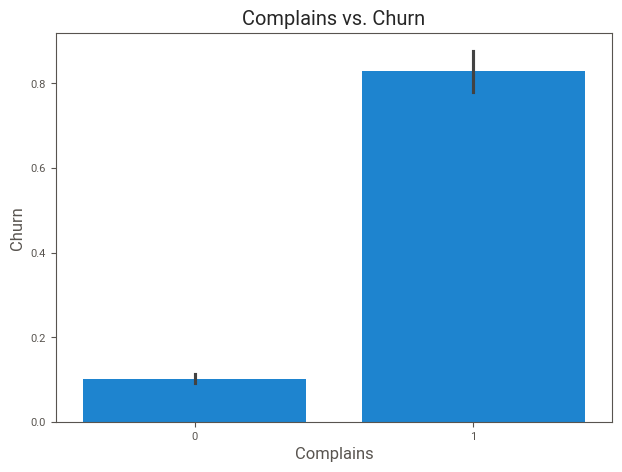

In [16]:
# Complains vs. Churn:

sns.barplot(x='Complains', y='Churn', data=df)
plt.title('Complains vs. Churn')
plt.show()


## <span style="color: #20C997;">Personal Analysis:</span>
Focus on resolving complaints, it can be to reduce churn and improve customer satisfaction.

In [17]:
# load the Maintenance dataset
df = pd.read_csv("maintenance.csv")
df.head()

,UDI,Product ID,Type,Air temperature [K],Process temperature [K],Rotational speed [rpm],Torque [Nm],Tool wear [min],Machine failure,TWF,HDF,PWF,OSF,RNF
0,1,M14860,M,298.10,308.60,1551,42.80,0,0,0,0,0,0,0
1,2,L47181,L,298.20,308.70,1408,46.30,3,0,0,0,0,0,0
2,3,L47182,L,298.10,308.50,1498,49.40,5,0,0,0,0,0,0
3,4,L47183,L,298.20,308.60,1433,39.50,7,0,0,0,0,0,0
4,5,L47184,L,298.20,308.70,1408,40.00,9,0,0,0,0,0,0


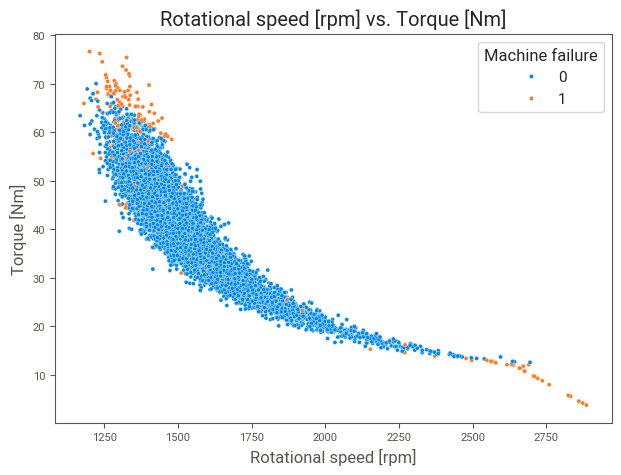

In [18]:
# Compare critical numerical features like Rotational speed vs. Torque with Machine failure .
sns.scatterplot(data=df, x="Rotational speed [rpm]", y="Torque [Nm]", hue="Machine failure")
plt.title("Rotational speed [rpm] vs. Torque [Nm]")
plt.show()

## <span style="color: #20C997;">Personal Analysis:</span>
Machine Failure happens at low speed, high torque and high speed, low torque ( it might be because of overheating).

In [19]:


# To check the data types of the columns in the DataFrame
df.dtypes

UDI                          int64
Product ID                  object
Type                        object
Air temperature [K]        float64
Process temperature [K]    float64
Rotational speed [rpm]       int64
Torque [Nm]                float64
Tool wear [min]              int64
Machine failure              int64
TWF                          int64
HDF                          int64
PWF                          int64
OSF                          int64
RNF                          int64
dtype: object

In [20]:
# Drop the Product ID column and Type column
df = df.drop(["Product ID", "Type"], axis=1)




In [21]:
# Define X nad y
X = df.drop("Machine failure", axis=1)
y = df["Machine failure"]


# convert all continuous variables to integer,
# and convert all negative numbers to 0
X_cat = X.astype(int)
X_cat = X_cat.clip(lower=0)

chi_features = SelectKBest(chi2, k=len(X_cat.columns))

# fit our data to the SelectKBest
best_features = chi_features.fit(X_cat, y.astype(int))

# use decimal format in table
pd.options.display.float_format = '{:.2f}'.format

# the higher the score, the more effect that column has on the target
df_features = pd.DataFrame(best_features.scores_)
df_columns = pd.DataFrame(X_cat.columns)
f_scores = pd.concat([df_columns, df_features], axis=1)
f_scores.columns = ['Features', 'Score']
f_scores.sort_values(by='Score', ascending=False)

,Features,Score
0,UDI,8733.04
5,Tool wear [min],4173.13
7,HDF,3277.33
9,OSF,2792.86
8,PWF,2707.36
6,TWF,1310.93
4,Torque [Nm],919.92
3,Rotational speed [rpm],407.82
1,Air temperature [K],0.96
10,RNF,0.20


## <span style="color: #20C997;">Personal Analysis:</span>
The most important factors for machine failure are Tool wear, UDI, HDF, OSF, and PWF.

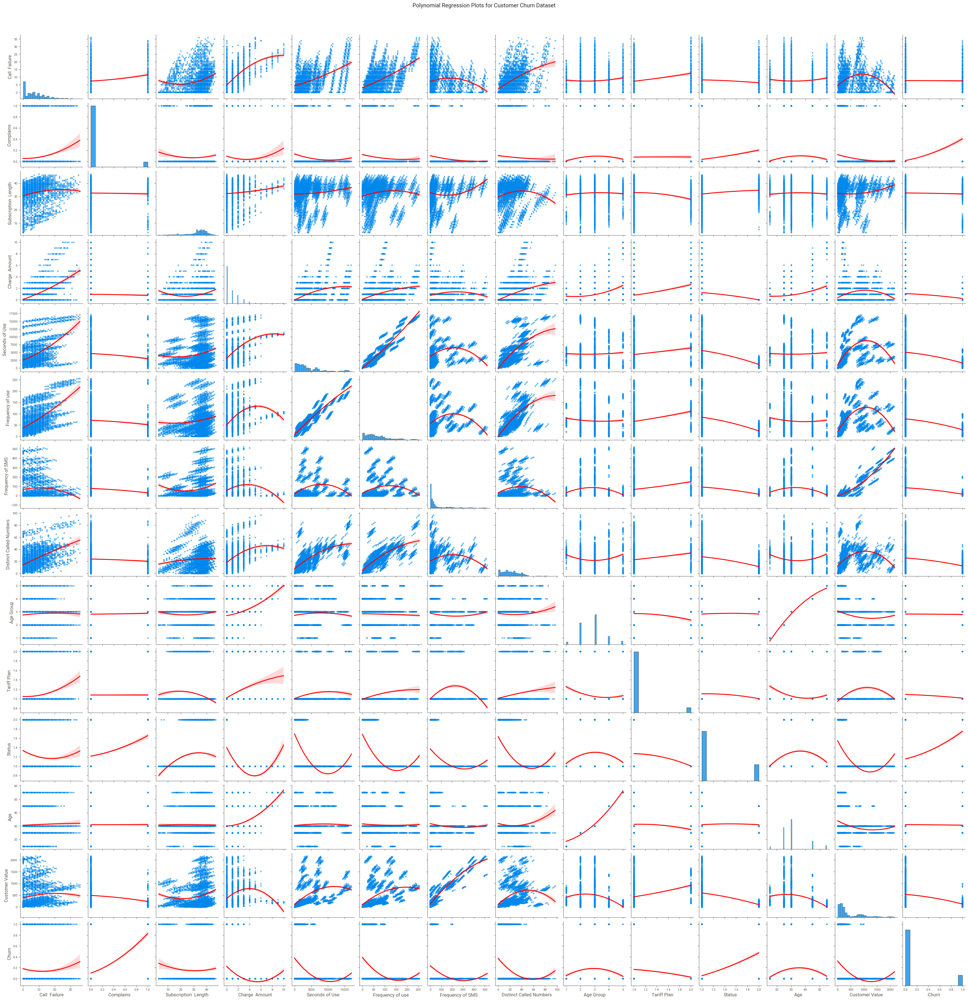

In [22]:
# Using polynomial regression plots for analysis of the Customer Churn dataset
sns.pairplot(data, kind="reg", plot_kws={'order': 2, 'line_kws': {'color': 'red'}, 'scatter_kws': {'alpha': 0.5}})
plt.suptitle("Polynomial Regression Plots for Customer Churn Dataset", y=1.02)
plt.show()


## <span style="color: #20C997;">Personal Analysis:</span>
The plots show that many features have a lot of scattered data, meaning there is quite a bit of noise.

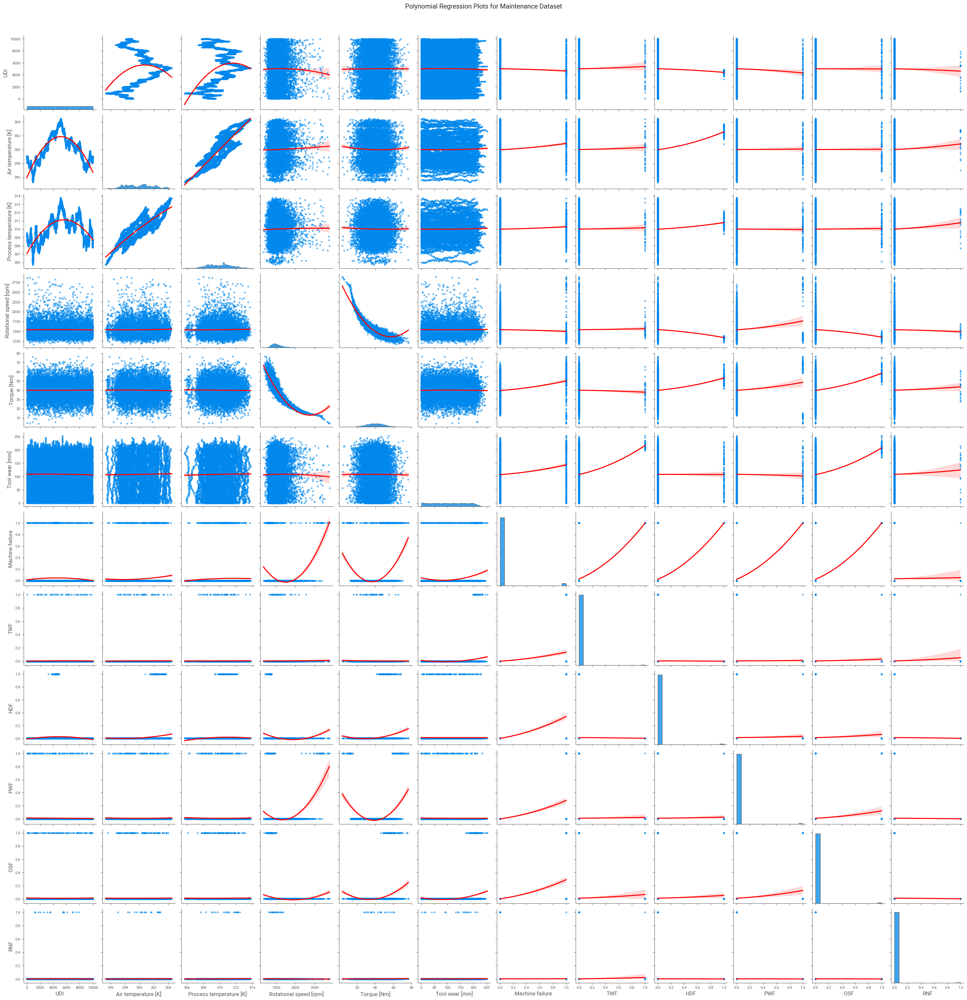

In [23]:
# Using polynomial regression plots for analysis of the Maintenance dataset
sns.pairplot(df, kind="reg", plot_kws={'order': 2, 'line_kws': {'color': 'red'}, 'scatter_kws': {'alpha': 0.5}})
plt.suptitle("Polynomial Regression Plots for Maintenance Dataset", y=1.02)
plt.show()


## <span style="color: #20C997;">Personal Analysis:</span>
The plots show high noise, outliers, poor polynomial fits, and correlations for many features.